In [1]:
import numpy as np
import sys
import glob 
import os 
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import scipy.io as sio
from scipy import stats
from natsort import natsorted, ns
import statistics as st

In [2]:
def ModeBaselineZscoreF(F,Fneu, a = 0.7, deg = 5, binSize = 3000):
    
    """Function in order to calculate the baseline of suite2p extracted fluo traces using mode and noise level
    approximation"""
    
    binSize =int(binSize)
    test = F - a*Fneu
    xts = []
    yts = []
    
    
    for tm in range(int(binSize/2),int((len(test)-binSize/2)),int(binSize)):
        xts.append(tm)
        winMode = int(stats.mode(test[int((tm-binSize/2)):int((tm+binSize/2))])[0])
        yts.append(winMode)
        
    p = np.polyfit(np.array(xts),np.array(yts),deg)
    
    bas = np.polyval(p,np.arange(len(test)))
    
    Fsub = test - bas
   
    sigma = np.std(np.concatenate((Fsub[Fsub>np.mean(Fsub)],-1*Fsub[Fsub<np.mean(Fsub)]),axis = 0))
    
    Fbas = Fsub/sigma
    
    #plt.figure(figsize=(5, 5))
    #plt.plot(test)
    #plt.plot(bas)
    #plt.figure(figsize=(5, 5))
    #plt.plot(Fbas)
    
    #plt.hist(yts, bins = 20)
    
    return Fbas

In [3]:
def ModeBaselineZscoreSpks(spks, deg = 5, binSize = 3000):
    
    """Function in order to calculate the baseline of suite2p extracted spike traces using mode and noise level
    approximation"""
    
    binSize =int(binSize)
    test = spks
    xts = []
    yts = []
    
    
    for tm in range(int(binSize/2),int((len(test)-binSize/2)),int(binSize)):
        xts.append(tm)
        winMode = int(stats.mode(test[int((tm-binSize/2)):int((tm+binSize/2))])[0])
        yts.append(winMode)
        
    p = np.polyfit(np.array(xts),np.array(yts),deg)
    
    bas = np.polyval(p,np.arange(len(test)))
    
    SpksSub = test - bas
   
    sigma = np.std(np.concatenate((SpksSub[SpksSub>np.mean(SpksSub)],-1*SpksSub[SpksSub<np.mean(SpksSub)]),axis = 0))
    
    SpksBas =  SpksSub/sigma

    return SpksBas

In [4]:
def MeanSigmaCalc(dataCR):
    
    """Calculate the meand and std of the correct rejection vector for zscoring the spiking data"""
    
    CR = dataCR
    CRresh = np.reshape(CR,[CR.shape[0],-1])
    mu = np.mean(CRresh, axis = 1)
    sigma = np.std(CRresh, axis = 1)
    
    return [mu, sigma];
    

In [6]:
mouseName = "GF201"
nframes = 211

# Hardcoded paths to the server
datapath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\analysis\\Georgios_Foustoukos\\DataAll\\' + mouseName + "\\" 
serverpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\Imaging\\'
behavpath = '\\\\sv1files.epfl.ch\\Petersen-Lab\\data\\' + mouseName + '\\Recordings\\BehaviourFiles\\'

# Detect the operating system to fix the slashes

if (os.name == "posix"):
    print("Linux or MacOS system detected")
    
    #Play with the names only important for MacOS
    
    datapath= datapath.replace('\\','/')
    datapath = '/Volumes/' + datapath[18:] 
    behavpath = behavpath.replace('\\','/')
    behavpath = '/Volumes' + behavpath[18:] 
    serverpath = serverpath.replace('\\','/')
    serverpath = '/Volumes' + serverpath[18:] 
    
else:
    print("Windows system detected")

# Find the imaging days
imaging_days = glob.glob(os.path.join(serverpath, "GF*"))

for n,f in enumerate(imaging_days):
    imaging_days[n] = os.path.basename(f)

# Sort the imaging days by year and month in case the order is not correct
year = []
month = []
for i,f in enumerate(imaging_days):
    year.append(f[-4:])
    month.append(f[-6:-4])

yearZip = []
yearZip = natsorted(list(zip(year,imaging_days)))
year_sorted = [x for y, x in yearZip]


year = []
month = []
for i,f in enumerate(year_sorted):
    year.append(f[-4:])
    month.append(f[-6:-4])


monthZip = []
monthZip = natsorted(list(zip(month,year_sorted)))
month_sorted = [x for y, x in monthZip]


imaging_days = month_sorted

# Thats a list of dictionaries where all the days for one mouse will be stored
AllData = []

DaysLength = np.zeros([1, len(imaging_days)])

for i,f in enumerate(imaging_days):
    
    frames_path = serverpath + imaging_days[i] + os.sep + 'TrialFrames.mat'
    
    print('Loading frames for splitting: ' + frames_path)
    
    frames = sio.loadmat(frames_path)

    numOfFrames = frames['NumOfFrames']

    numOfFrames = np.array(numOfFrames)
    
    DaysLength[0,i] = np.sum(numOfFrames)
    
#Create the paths to the suite2p files

F_path = datapath + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "F.npy"
Fneu_path = datapath + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "Fneu.npy"
iscell_path = datapath + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "iscell.npy"
spks_path = datapath  + os.sep + 'suite2p' + os.sep + 'plane0' + os.sep + "spks.npy"

print('Loading suite2p files ...')

FAll = np.load(F_path)
FneuAll = np.load(Fneu_path)
spksAll = np.load(spks_path)
iscell = np.load(iscell_path)

print('Files loaded')

#Keep only the ROIs detected as cells 
        
FAll = FAll[iscell[:,0]==1.]
FneuAll = FneuAll[iscell[:,0]==1.]
spksAll = spksAll[iscell[:,0]==1.]


for d in range(DaysLength.shape[1]):
    
    
    F = FAll[:,int(np.sum(DaysLength[0,0:d])):int(np.sum(DaysLength[0,0:(d+1)]))]
    Fneu = FneuAll[:,int(np.sum(DaysLength[0,0:d])):int(np.sum(DaysLength[0,0:(d+1)]))]
    spks = spksAll[:,int(np.sum(DaysLength[0,0:d])):int(np.sum(DaysLength[0,0:(d+1)]))]
    Fbas = np.empty([F.shape[0],F.shape[1]])
    spksbas =  np.empty([spks.shape[0],spks.shape[1]])
    
    
    for n in range(Fbas.shape[0]):
        Fbas[n][:] = ModeBaselineZscoreF(F[n,:],Fneu[n,:],0.7,5,1000)
        spksbas[n][:] = ModeBaselineZscoreSpks(spks[n,:],5,1000)
        
        
    print('Baselines for F and spks calculated')
  

    print('Number of Selected ROIs : ' + str(F.shape[0]))
    
    #Load the behaviour files from the server (.mat files)

    behav_path = behavpath + imaging_days[d] + os.sep + 'BehavResults.mat'

    print('Loading behaviour: ' + behav_path)

    beh = sio.loadmat(behav_path)

    vals = beh['BehavResults'][0,0]

    keys = beh['BehavResults'][0,0].dtype.descr

    beh = np.array(vals[keys[0][0]][:][:])
    
    #keep the performance column from the behaviour file

    performance = beh[:,9]
    
    #Load the frames info from the server (.mat files)

    frames_path = serverpath + imaging_days[d] + os.sep + 'TrialFrames.mat'

    print('Loading frame info for trial splitting: ' +  frames_path)

    frames = sio.loadmat(frames_path)

    numOfFrames = frames['NumOfFrames']

    numOfFrames = np.array(numOfFrames)

    # Create an empty dict from every day to store the data

    daysDict = dict.fromkeys(['dayName','WM','AM','WH','AH','CR','FA','muCRspks','sigmaCRspks'])


    #Create an empty dict from every trial type and measure of suite2p 
    
    dataDictWM = dict.fromkeys(['WMF','WMFneu','WMFbas','WMspks','WMspksbas'])
    dataDictWH = dict.fromkeys(['WHF','WHFneu','WHFbas','WHspks','WHspksbas'])
    dataDictAH = dict.fromkeys(['AHF','AHFneu','AHFbas','AHspks','AHspksbas'])
    dataDictAM = dict.fromkeys(['AMF','AMFneu','AMFbas','AMspks','AMspksbas'])
    dataDictFA = dict.fromkeys(['FAF','FAFneu','FAFbas','FAspks','FAspksbas'])
    dataDictCR = dict.fromkeys(['CRF','CRFneu','CRFbas','CRspks','CRspksbas'])

    #Trial type counters all set to zero

    WMc = 0;
    AMc = 0;
    WHc = 0;
    AHc = 0;
    CRc = 0;
    FAc = 0;

    # Initalise the data core structure as an numpy array or dimensions cells x frames x trials for every trial type 
  

    WMF = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
    WMFneu = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
    WMFbas = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
    WMspks = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])
    WMspksbas = np.zeros([F.shape[0],nframes,sum(performance == 0.0)])

    AMF = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
    AMFneu = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
    AMFbas = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
    AMspks = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])
    AMspksbas = np.zeros([F.shape[0],nframes,sum(performance == 1.0)])

    WHF = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
    WHFneu = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
    WHFbas = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
    WHspks = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])
    WHspksbas = np.zeros([F.shape[0],nframes,sum(performance == 2.0)])

    AHF = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
    AHFneu = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
    AHFbas = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
    AHspks = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])
    AHspksbas = np.zeros([F.shape[0],nframes,sum(performance == 3.0)])


    CRF = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
    CRFneu = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
    CRFbas = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
    CRspks = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])
    CRspksbas = np.zeros([F.shape[0],nframes,sum(performance == 4.0)])

    FAF = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
    FAFneu = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
    FAFbas = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
    FAspks = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])
    FAspksbas = np.zeros([F.shape[0],nframes,sum(performance == 5.0)])


    for t in range(len(performance)):
        
        #Check the performance outcome using the frame info read the num of frames from the long suite2p vector
        
        if performance[t] == 0.0:
            WMF[:,:,WMc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WMFneu[:,:,WMc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WMFbas[:,:,WMc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WMspks[:,:,WMc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WMspksbas[:,:,WMc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WMc += 1 

        elif performance[t] == 1.0:
            AMF[:,:,AMc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AMFneu[:,:,AMc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AMFbas[:,:,AMc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AMspks[:,:,AMc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AMspksbas[:,:,AMc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AMc += 1  

        elif performance[t] == 2.0:
            WHF[:,:,WHc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WHFneu[:,:,WHc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WHFbas[:,:,WHc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WHspks[:,:,WHc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WHspksbas[:,:,WHc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            WHc += 1

        elif performance[t] == 3.0:
            AHF[:,:,AHc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AHFneu[:,:,AHc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AHFbas[:,:,AHc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AHspks[:,:,AHc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AHspksbas[:,:,AHc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            AHc += 1

        elif performance[t] == 4.0:
            CRF[:,:,CRc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            CRFneu[:,:,CRc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            CRFbas[:,:,CRc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            CRspks[:,:,CRc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            CRspksbas[:,:,CRc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            CRc += 1

        elif performance[t] == 5.0:
            FAF[:,:,FAc] = F[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            FAFneu[:,:,FAc] = Fneu[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            FAFbas[:,:,FAc] = Fbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            FAspks[:,:,FAc] = spks[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            FAspksbas[:,:,FAc] = spksbas[:,int(np.sum(numOfFrames[0:t])):int((np.sum(numOfFrames[0:t])+ 211))]
            FAc += 1 
            
    
    # Store numpy matrices to the dictionaries for each trial type
    dataDictWM = {'WMF' : WMF ,
                  'WMFneu' : WMFneu,
                  'WMFbas' : WMFbas,
                  'WMspks' : WMspks,
                  'WMspksbas' : WMspksbas
    }
    dataDictWH = {'WHF' : WHF ,
                  'WHFneu' : WHFneu,
                  'WHFbas' : WHFbas,
                  'WHspks' : WHspks,
                  'WHspksbas' : WHspksbas
    }
    dataDictAM = {'AMF' : AMF ,
                  'AMFneu' : AMFneu,
                  'AMFbas' : AMFbas,
                  'AMspks' : AMspks,
                  'AMspksbas' : AMspks
    }
    dataDictAH = {'AHF' : AHF ,
                  'AHFneu' : AHFneu,
                  'AHFbas' : AHFbas,
                  'AHspks' : AHspks,
                  'AHspksbas' : AHspksbas
    }
    dataDictCR = {'CRF' : CRF ,
                  'CRFneu' : CRFneu,
                  'CRFbas' : CRFbas,
                  'CRspks' : CRspks,
                  'CRspksbas' : CRspksbas
    }
    dataDictFA = {'FAF' : FAF ,
                  'FAFneu' : FAFneu,
                  'FAFbas' : FAFbas,
                  'FAspks' : FAspks,
                  'FAspksbas' : FAspksbas
    }
    
    [muCRspks, sigmaCRspks] = MeanSigmaCalc(CRspks)
    
    # Store the small dicts i the big dict of each day together with its name 
    daysDict = { 'dayName' : imaging_days[d],
                 'WM' : dataDictWM,
                 'WH' : dataDictWH,
                 'AM' : dataDictAM,
                 'AH' : dataDictAH,
                 'CR' : dataDictCR,
                 'FA' : dataDictFA,
                 'muCRspks' : muCRspks,
                 'sigmaCRspks' : sigmaCRspks
    }
    #Append the big list for all the data for one mouse
    AllData.append(daysDict)


Windows system detected
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\Imaging\GF201_05092019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\Imaging\GF201_06092019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\Imaging\GF201_07092019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\Imaging\GF201_08092019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\Imaging\GF201_09092019\TrialFrames.mat
Loading frames for splitting: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\Imaging\GF201_10092019\TrialFrames.mat
Loading suite2p files ...
Files loaded
Baselines for F and spks calculated
Number of Selected ROIs : 430
Loading behaviour: \\sv1files.epfl.ch\Petersen-Lab\data\GF201\Recordings\BehaviourFiles\GF201_05092019\BehavResults.mat
Loading frame

In [ ]:
DaysLength

In [ ]:
imaging_days

In [ ]:
data = AllData[0]['CR']['CRspks']
[mu, sigma] = MeanSigmaCalc(data)

In [ ]:
Test = stats.zscore(AllData[0]['WM']['WMspks'],axis =1)
meanTrials = np.mean(Test, axis = 2)
meanTrials.shape
testx = meanTrials[100][:]
plt.plot(testx)
base = testx[51:60]
test = testx[60:66]
[s,p] = stats.ranksums(base,test)
p


In [ ]:
plt.figure(figsize=(30, 25))
CellsSign = np.zeros([1,6])
CellIndexes = [];
for d in range(6):
    cC = 0
    CR = AllData[d]['CR']['CRspks']
    CRresh = np.reshape(CR,[CR.shape[0],-1])
    mu = np.mean(CRresh, axis = 1)
    sigma = np.std(CRresh, axis = 1)
    dayData = AllData[d]['WM']['WMspks']
    meanTrials = np.mean(dayData,axis = 2)
    CellsIdx = [];
    for i in range(meanTrials.shape[0]):
        dataZscore = (meanTrials[i] - mu[i])/sigma[i]
        base = dataZscore[50:59]
        test = dataZscore[61:66]
        [s,p] = stats.ranksums(base,test)
        if p < 0.05 :
            cC += 1
            #plt.figure(figsize=(5, 5))
            #plt.plot(dataZscore)
            #plt.title(str(p))
            CellsIdx.append(i)
    CellsSign[0][d] = cC
    CellIndexes.append(CellsIdx)

In [25]:
CellIndexes

[[2,
  9,
  10,
  12,
  13,
  24,
  25,
  27,
  29,
  31,
  34,
  35,
  38,
  44,
  48,
  51,
  62,
  63,
  66,
  71,
  75,
  77,
  78,
  86,
  87,
  89,
  92,
  93,
  96,
  98,
  99,
  104,
  115,
  116,
  119,
  122,
  127,
  129,
  132,
  135,
  138,
  140,
  149,
  158,
  160,
  165,
  168,
  170,
  171,
  176,
  177,
  178,
  185,
  190,
  191,
  194,
  195,
  198,
  199,
  200,
  202,
  203,
  209,
  213,
  218,
  222,
  224,
  226,
  227,
  228,
  231,
  233,
  242,
  248,
  251,
  252,
  263,
  264,
  268,
  279,
  282,
  283,
  285,
  286,
  288,
  289,
  294,
  306,
  307,
  310,
  316,
  321,
  322,
  324,
  325,
  326,
  330,
  332,
  335,
  337,
  338,
  340,
  344,
  345,
  347,
  348,
  353,
  356,
  357,
  363,
  364,
  365,
  368,
  372,
  374,
  377,
  378,
  383,
  389,
  390,
  395,
  398,
  399,
  402,
  405,
  420,
  423,
  424,
  426,
  428],
 [1,
  3,
  8,
  13,
  15,
  16,
  23,
  24,
  29,
  32,
  35,
  36,
  37,
  38,
  42,
  46,
  47,
  52,
  54,
  55,
  59,

C:\Users\foustouk\.conda\envs\suite2p\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


<Figure size 2160x1800 with 0 Axes>

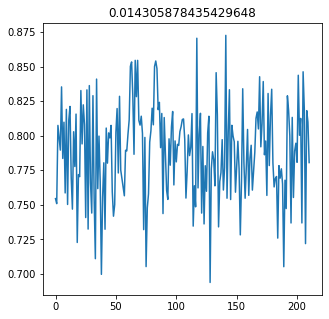

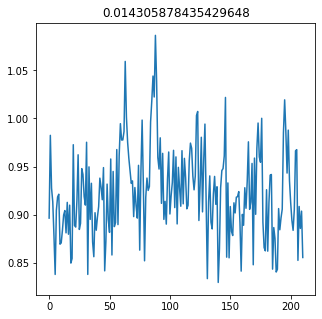

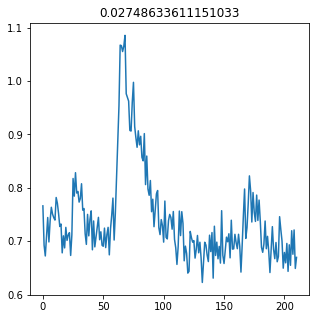

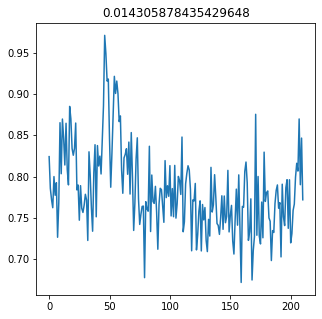

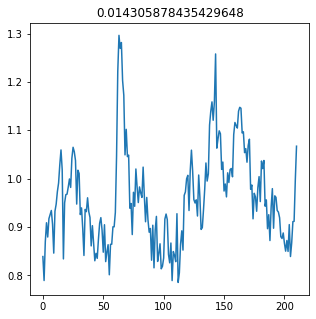

...

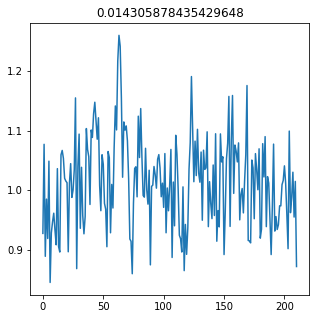

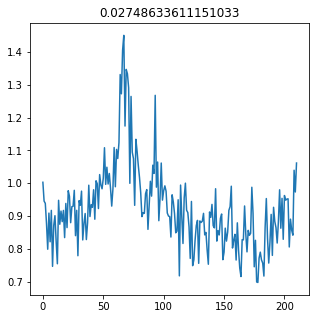

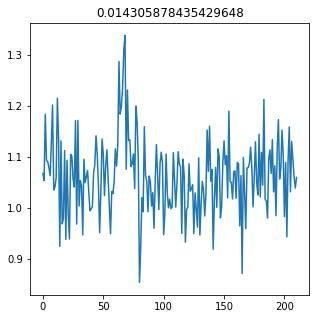

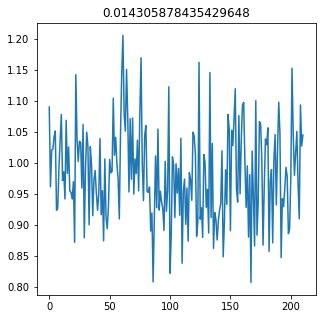

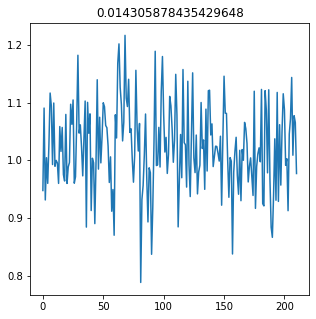

In [20]:
plt.figure(figsize=(30, 25))
CellsSign = np.zeros([1,6])
CellIndexes = [];
for d in range(6):
    cC = 0
    dayData = AllData[d]['WM']['WMFbas']
    meanTrials = np.mean(dayData,axis = 2)
    CellsIdx = [];
    for i in range(meanTrials.shape[0]):
        dataZscore = (meanTrials[i])
        base = dataZscore[55:59]
        test = dataZscore[60:65]
        [s,p] = stats.ranksums(base,test)
        if p < 0.05 :
            cC += 1
            plt.figure(figsize=(5, 5))
            plt.plot(dataZscore)
            plt.title(str(p))
            CellsIdx.append(i)
    CellsSign[0][d] = cC
    CellIndexes.append(CellsIdx)

In [21]:
CellsSign

array([[130., 135., 139., 121., 100., 107.]])

In [ ]:
A = AllData[4]['WM']['WMspks']
A.shape

B = np.reshape(A,[A.shape[0],-1])
B.shape
plt.plot(np.mean(B,axis = 0))
C = np.std(B,axis =1)
C.shape

In [27]:
CellIndexes

[[2,
  9,
  10,
  12,
  13,
  24,
  25,
  27,
  29,
  31,
  34,
  35,
  38,
  44,
  48,
  51,
  62,
  63,
  66,
  71,
  75,
  77,
  78,
  86,
  87,
  89,
  92,
  93,
  96,
  98,
  99,
  104,
  115,
  116,
  119,
  122,
  127,
  129,
  132,
  135,
  138,
  140,
  149,
  158,
  160,
  165,
  168,
  170,
  171,
  176,
  177,
  178,
  185,
  190,
  191,
  194,
  195,
  198,
  199,
  200,
  202,
  203,
  209,
  213,
  218,
  222,
  224,
  226,
  227,
  228,
  231,
  233,
  242,
  248,
  251,
  252,
  263,
  264,
  268,
  279,
  282,
  283,
  285,
  286,
  288,
  289,
  294,
  306,
  307,
  310,
  316,
  321,
  322,
  324,
  325,
  326,
  330,
  332,
  335,
  337,
  338,
  340,
  344,
  345,
  347,
  348,
  353,
  356,
  357,
  363,
  364,
  365,
  368,
  372,
  374,
  377,
  378,
  383,
  389,
  390,
  395,
  398,
  399,
  402,
  405,
  420,
  423,
  424,
  426,
  428],
 [1,
  3,
  8,
  13,
  15,
  16,
  23,
  24,
  29,
  32,
  35,
  36,
  37,
  38,
  42,
  46,
  47,
  52,
  54,
  55,
  59,

In [ ]:
plt.figure(figsize=(30, 25))
for d in range(6):
    CR = AllData[d]['CR']['CRspks']
    CRresh = np.reshape(CR,[CR.shape[0],-1])
    mu = np.mean(CRresh, axis = 1)
    sigma = np.std(CRresh, axis = 1)
    dayData = AllData[d]['WM']['WMspks']
    maxPoints = np.zeros([1,len(CellIndexes[d])])
    print(len(CellIndexes[d]))
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(len(CellIndexes[d])):
        dataZscore = (meanTrials[CellIndexes[d][i]] - mu[CellIndexes[d][i]])/sigma[CellIndexes[d][i]]
        baseline = dataZscore[50:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(dataZscore[61:66]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(len(CellIndexes[d])),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

130
135
139
121
100
107


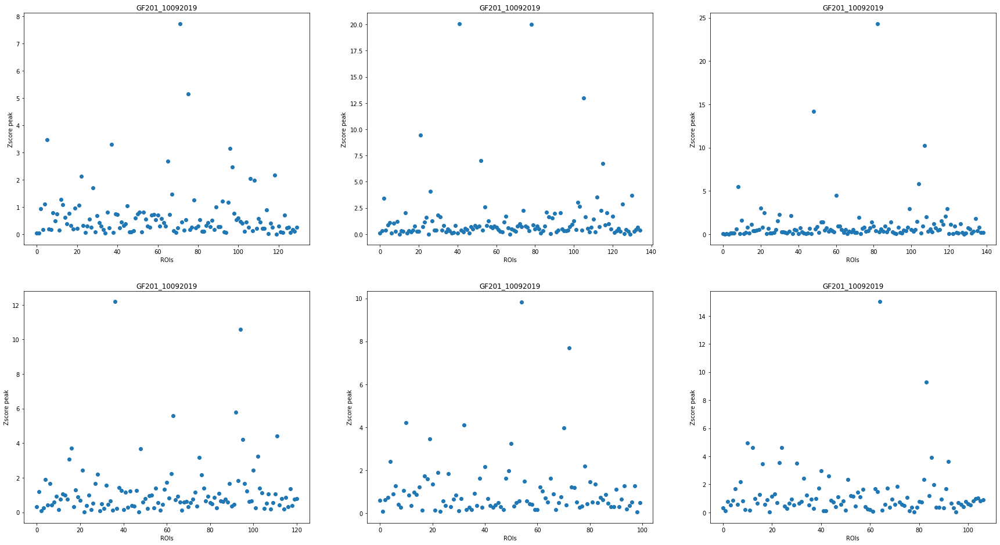

In [28]:
plt.figure(figsize=(30, 25))
for d in range(6):
    dayData = AllData[d]['WM']['WMspksbas']
    maxPoints = np.zeros([1,len(CellIndexes[d])])
    print(len(CellIndexes[d]))
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(len(CellIndexes[d])):
        dataZscore = (meanTrials[CellIndexes[d][i]])
        baseline = dataZscore[55:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(dataZscore[60:65]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(len(CellIndexes[d])),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

In [ ]:
d = 1
CR = AllData[d]['CR']['CRspks']
CRresh = np.reshape(CR,[CR.shape[0],-1])
mu = np.mean(CRresh, axis = 1)
sigma = np.std(CRresh, axis = 1)
dayData = AllData[d]['WM']['WMspks']
maxPoints = np.zeros([1,len(CellIndexes[d])])

meanTrials = np.mean(dayData,axis = 2)
meanTrials.shape


In [ ]:
plt.figure(figsize=(30, 25))
for d in range(6):
    dayData = stats.zscore(AllData[d]['WM']['WMspks'],axis =1)
    maxPoints = np.zeros([1,len(CellIndexes[d])])
    print(len(CellIndexes[d]))
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(len(CellIndexes[d])):
        baseline = meanTrials[CellIndexes[d][i]][50:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(meanTrials[CellIndexes[d][i]][61:66]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(len(CellIndexes[d])),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

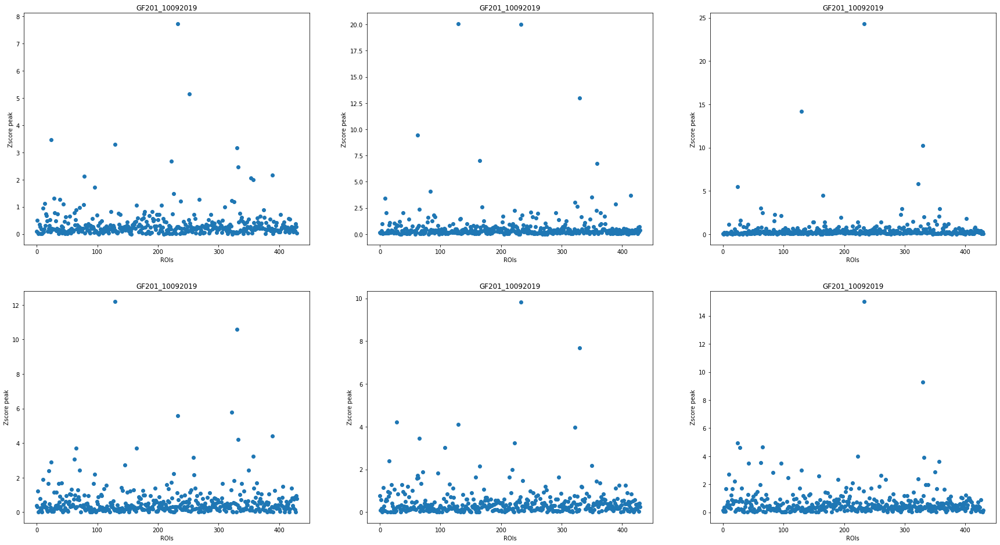

In [18]:
plt.figure(figsize=(30, 25))
for d in range(6):
    dayData = AllData[d]['WM']['WMspksbas']
    maxPoints = np.zeros([1,dayData.shape[0]])
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(meanTrials.shape[0]):
        baseline = meanTrials[i][55:59]
        maxPoints[0][i] = np.abs(np.mean(baseline) - np.max(meanTrials[i][60:65]))
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(meanTrials.shape[0]),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')

In [ ]:
plt.scatter(range(Test2.shape[0]),maxPoints[0][:])

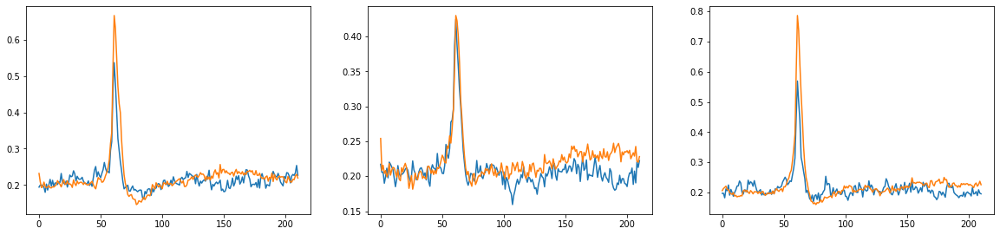

In [7]:
plt.plot(np.mean(AllData[i]['WM']['WMFbas'],axis = (0,2))[:])

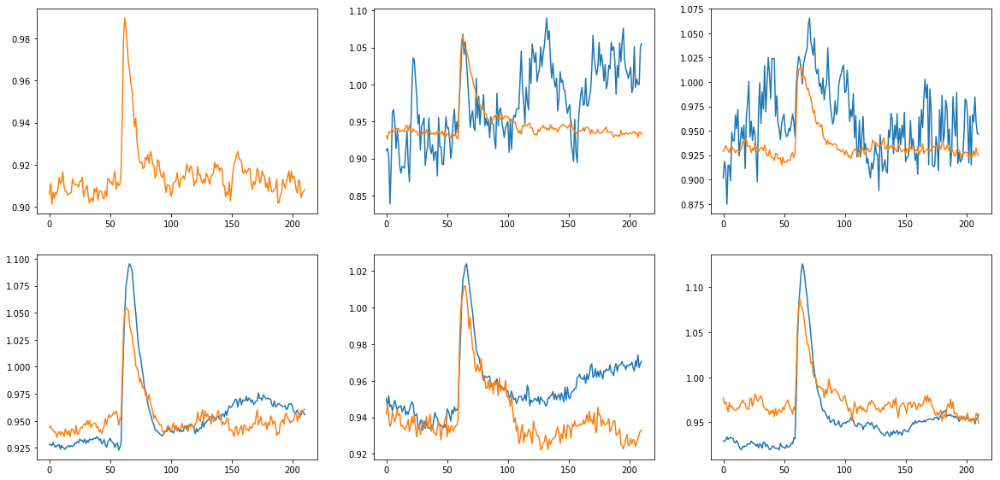

In [11]:
plt.figure(figsize=(20, 15))
for i in range(6):
    plt.subplot(3,3,i+1)
    plt.plot(np.mean(AllData[i]['WH']['WHFbas'],axis = (0,2))[:])
    plt.plot(np.mean(AllData[i]['WM']['WMFbas'],axis = (0,2))[:])

In [ ]:
list(range(3,6,1))

In [ ]:
np.mean(AllData[i]['WH']['WHFbas'],axis = (0,2))[:]

In [ ]:
A  =  ModeBaselineZscoreSpks(spks[300,:],5,3000)
plt.plot(A)

In [ ]:
B = F[10,:]-Bas

A = np.concatenate((B[B>0],-1*B[B<0]),axis = 0)

plt.plot(A)

In [ ]:
np.std(spks[100,:])

In [ ]:
Fbas[1][:] = ModeBaselineZscoreF(F[10,:],Fneu[10,:],0.7,5,1000)

In [ ]:
per

In [ ]:
t = 0
performance[t]

In [ ]:
performance[t] == 2.0
A = range(int(np.sum(numOfFrames[0:t])),int((np.sum(numOfFrames[0:t])+ 211)))

In [ ]:
list(A)

In [ ]:
int(np.sum(numOfFrames[0:t]))

In [11]:
plt.figure(figsize=(30, 25))
maxPoints = np.zeros([6,430])
for d in range(6):
    dayData = AllData[d]['WM']['WMspksbas']
    meanTrials = np.mean(dayData,axis = 2)
    for i in range(meanTrials.shape[0]):
        baseline = meanTrials[i][56:59]
        print(d)
        print(i)
        
        maxPoints[d][i] = np.abs(np.mean(baseline) - np.max(meanTrials[i][60:63]))
        print(maxPoints)


0
0
[[0.08670569 0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
0
1
[[0.08670569 0.01924639 0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
0
2
[[0.08670569 0.01924639 0.02850439 ... 0.         0.         0.        ]
 [0.         0.         0.         ..

1
0
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
1
1
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
1
2
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ..

340
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
1
341
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
1
342
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.0851819

2
271
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
2
272
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
2
273
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518

 [0.         0.         0.         ... 0.         0.         0.        ]]
3
219
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.04633954 0.03172979 0.02418942]
 [0.11573725 0.38372639 1.19232459 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
3
220
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.04633954 0.03172979 0.02418942]
 [0.11573725 0.38372639 1.19232459 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
3
221
[[0.08670569 0.01924639 0.0285

 [0.         0.         0.         ... 0.         0.         0.        ]]
4
165
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.04633954 0.03172979 0.02418942]
 [0.11573725 0.38372639 1.19232459 ... 0.02148864 0.87156259 0.79469058]
 [0.07931579 0.06589041 0.58170215 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
4
166
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.04633954 0.03172979 0.02418942]
 [0.11573725 0.38372639 1.19232459 ... 0.02148864 0.87156259 0.79469058]
 [0.07931579 0.06589041 0.58170215 ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
4
167
[[0.08670569 0.01924639 0.0285

 [0.11123985 0.0629018  0.30968128 ... 0.         0.         0.        ]]
5
98
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.04633954 0.03172979 0.02418942]
 [0.11573725 0.38372639 1.19232459 ... 0.02148864 0.87156259 0.79469058]
 [0.07931579 0.06589041 0.58170215 ... 0.01669311 0.37216204 0.28811612]
 [0.11123985 0.0629018  0.30968128 ... 0.         0.         0.        ]]
5
99
[[0.08670569 0.01924639 0.02850439 ... 0.40066097 0.21089145 0.03714917]
 [0.13178489 0.01831137 0.08518198 ... 0.01929141 0.73316806 0.22363329]
 [0.07115518 0.04363456 0.20321755 ... 0.04633954 0.03172979 0.02418942]
 [0.11573725 0.38372639 1.19232459 ... 0.02148864 0.87156259 0.79469058]
 [0.07931579 0.06589041 0.58170215 ... 0.01669311 0.37216204 0.28811612]
 [0.11123985 0.0629018  0.30968128 ... 0.         0.         0.        ]]
5
100
[[0.08670569 0.01924639 0.028504

<Figure size 2160x1800 with 0 Axes>

In [35]:
d = 1
i = 1
baseline = meanTrials[i][55:59]

C:\Users\foustouk\.conda\envs\suite2p\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<Figure size 1440x1080 with 0 Axes>

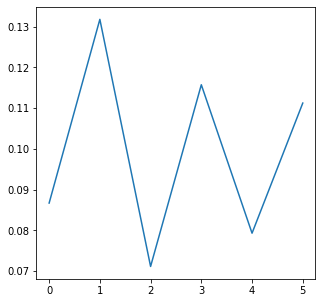

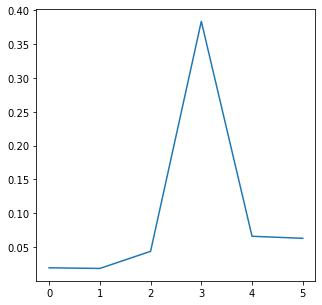

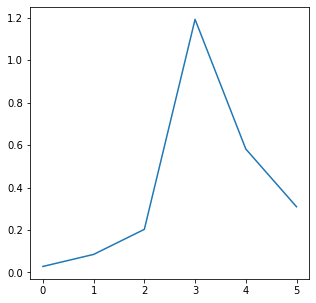

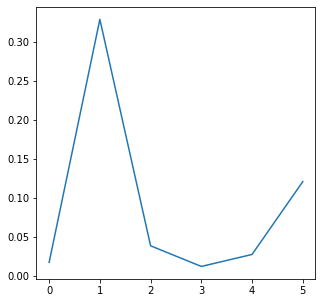

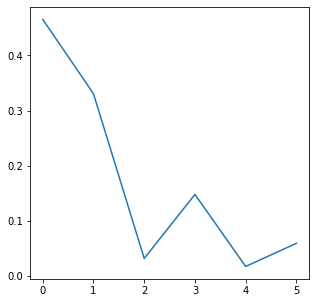

...

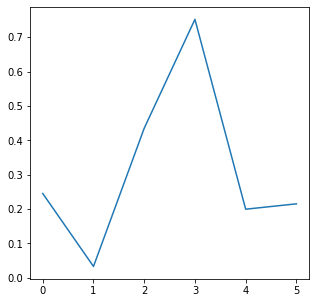

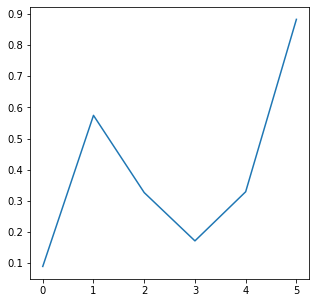

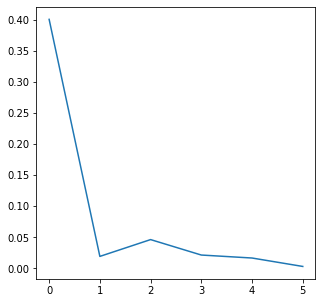

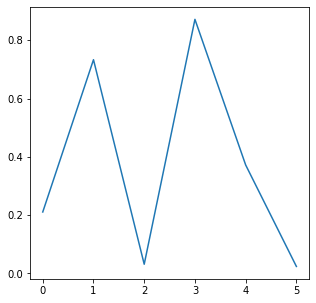

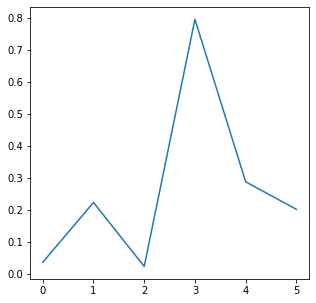

In [12]:
plt.figure(figsize=(20, 15))
for i in range(430):
    plt.figure(figsize=(5, 5))
    plt.plot(maxPoints[:,i])

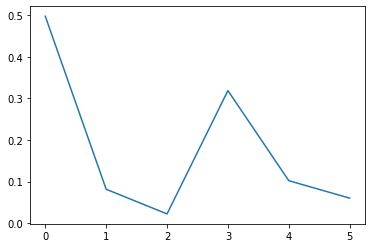

In [ ]:
        
    plt.subplot(3,3,d+1)
    plt.scatter(range(meanTrials.shape[0]),maxPoints[0][:])
    plt.title(AllData[d]['dayName'])
    plt.xlabel('ROIs')
    plt.ylabel('Zscore peak')